In [1]:
import os, sys
import tqdm
import torch
import numpy as np
import xarray as xr
import matplotlib.pyplot as plt
import time

import yaml
from numpy import random
import sys

from matplotlib import colormaps

In [2]:
from torch.utils.data.distributed import DistributedSampler
import torch.distributed as dist

In [3]:
from holodec.datasets import LoadHolograms, UpsamplingReader
from holodec.unet import SegmentationModel
from holodec.transforms import LoadTransformations

/glade/work/mhayman/conda-envs/holodec/lib/python3.12/site-packages/torchvision/io/image.py:13: UserWarning: Failed to load image Python extension: '/glade/work/mhayman/conda-envs/holodec/lib/python3.12/site-packages/torchvision/image.so: undefined symbol: _ZN3c1017RegisterOperatorsD1Ev'If you don't plan on using image functionality from `torchvision.io`, you can ignore this warning. Otherwise, there might be something wrong with your environment. Did you have `libjpeg` or `libpng` installed before building `torchvision` from source?
  warn(


In [4]:
# results_path = "/glade/derecho/scratch/mhayman/miles-holodec/results/"
# results_path = "/glade/derecho/scratch/mhayman/miles-holodec/results_weighted/"
# results_path = "/glade/derecho/scratch/mhayman/miles-holodec/results_weighted_2/"
# results_path = "/glade/derecho/scratch/mhayman/miles-holodec/results_weighted_3/"
# results_path = "/glade/derecho/scratch/mhayman/miles-holodec/results_weighted_4/"
results_path = "/glade/derecho/scratch/mhayman/miles-holodec/results_weighted_11/"

In [5]:
config = os.path.join(results_path,"model.yml")

In [6]:
# Load the configuration and get the relevant variables
with open(config) as cf:
    conf = yaml.load(cf, Loader=yaml.FullLoader)

In [7]:
print(conf['training_data']['lookahead'])
print(conf['training_data']['n_bins'])
print(conf['loss']['training_loss_depth_mult'])

5
100
0.1


In [8]:
is_cuda = torch.cuda.is_available()
device = torch.device(torch.cuda.current_device()) if is_cuda else torch.device("cpu")

if is_cuda:
    torch.backends.cudnn.benchmark = True
    #torch.backends.cudnn.deterministic = True

In [9]:
# model
model = SegmentationModel(conf)
model.to(device)

# Load an optimizer, scheduler, and gradient scaler from disk if epoch > 0

# model, optimizer, scheduler, scaler = load_model_and_optimizer(conf, model, device)

###
# vae = SegmentationModel(conf)
# vae.to(device)
# model = distributed_model_wrapper(conf, vae, device)

# # Load an optimizer, scheduler, and gradient scaler from disk if epoch > 0

# model, optimizer, scheduler, scaler = load_model_and_optimizer(conf, model, device)

SegmentationModel(
  (activations): ModuleList(
    (0): Sigmoid()
    (1): Identity()
  )
  (model): FPN(
    (encoder): ResNetEncoder(
      (conv1): Conv2d(10, 64, kernel_size=(7, 7), stride=(2, 2), padding=(3, 3), bias=False)
      (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (relu): ReLU(inplace=True)
      (maxpool): MaxPool2d(kernel_size=3, stride=2, padding=1, dilation=1, ceil_mode=False)
      (layer1): Sequential(
        (0): Bottleneck(
          (conv1): Conv2d(64, 64, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn1): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv2): Conv2d(64, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
          (bn2): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
          (conv3): Conv2d(64, 256, kernel_size=(1, 1), stride=(1, 1), bias=False)
          (bn3): BatchNorm2d(256, eps=1e-05, 

In [10]:
ckpt = os.path.join(results_path,"checkpoint.pt")
checkpoint = torch.load(ckpt, map_location=device)

In [11]:
checkpoint['epoch']

7

In [12]:
model.load_state_dict(checkpoint['model_state_dict'])

<All keys matched successfully>

# Load Dataset

In [13]:
# conf["validation_data"]["lookahead"] = int(conf["validation_data"]["lookahead"][0])

In [14]:
conf["validation_data"]["device"] = device
conf["validation_data"]["transform"] = LoadTransformations(conf["transforms"]["validation"])
conf["validation_data"]["output_lst"] = [torch.abs, torch.angle]

# Create the UpsamplingReader using the updated configuration
valid_dataset = UpsamplingReader(**conf["validation_data"])
valid_batch_size = 10 # conf["trainer"]["valid_batch_size"]

rank = 0
world_size = 1
seed = 1000

valid_sampler = DistributedSampler(
            valid_dataset,
            num_replicas=world_size,
            rank=rank,
            seed=seed, 
            shuffle=False, 
            drop_last=True
        )

In [15]:
valid_loader = torch.utils.data.DataLoader(
    valid_dataset,
    batch_size=valid_batch_size,
    shuffle=False,
    sampler=valid_sampler,
    pin_memory=False,
    num_workers=0,
    drop_last=True
)

In [16]:
# z output is normalized by the spacing between planes.  Larger lookahead means larger z min and max
z_max = (conf['training_data']['lookahead'] - 1)/2

In [17]:
model.eval()

valid_batches_per_epoch = conf['trainer']['valid_batches_per_epoch']
distributed = True if conf["trainer"]["mode"] in ["fsdp", "ddp"] else False

# results_dict = defaultdict(list)

# set up a custom tqdm
# valid_batches_per_epoch = (
#     valid_batches_per_epoch if 0 < valid_batches_per_epoch < len(valid_loader) else len(valid_loader)
# )
valid_batches_per_epoch = 1

batch_group_generator = tqdm.tqdm(
    range(valid_batches_per_epoch), total=valid_batches_per_epoch, leave=True
)

with torch.no_grad():
    start_time = time.time()
    for k, (x, y_part_mask, y_depth_mask, y_weight_mask) in enumerate(valid_loader):

        y_pred = model(x)

        y_part_mask = y_part_mask.to(y_pred.device, y_pred.dtype)
        y_depth_mask = y_depth_mask.to(y_pred.device, y_pred.dtype)
        y_weight_mask = y_weight_mask.to(y_pred.device, y_pred.dtype)

        # mask_loss = criterion[0](y_part_mask, y_pred[:, 0])
        # depth_loss = criterion[1](y_depth_mask*y_part_mask, y_pred[:, 1]*y_part_mask)

        # Mask metrics
        # for name, metric in metrics[0].items():
        #     value = metric(y_part_mask, y_pred[:, 0])
        #     value = torch.Tensor([value]).cuda(self.device, non_blocking=True)
        #     if distributed:
        #         dist.all_reduce(value, dist.ReduceOp.AVG, async_op=False)
        #     results_dict[f"valid_{name}"].append(value[0].item())

        # # Depth metrics
        # for name, metric in metrics[1].items():
        #     value = metric(y_depth_mask, y_pred[:, 1])
        #     value = torch.Tensor([value]).cuda(self.device, non_blocking=True)
        #     if distributed:
        #         dist.all_reduce(value, dist.ReduceOp.AVG, async_op=False)
        #     results_dict[f"valid_{name}"].append(value[0].item())

        # loss = (mask_loss + depth_loss).mean()

        # for key, _loss in zip(["loss", "mask_loss", "depth_loss"], [loss, mask_loss, depth_loss]):
        #     batch_loss = torch.Tensor([_loss.mean().item()]).cuda(self.device)
        #     if distributed:
        #         torch.distributed.barrier()
        #     results_dict[f"valid_{key}"].append(batch_loss[0].item())

        # # agg the results
        # to_print = "Epoch (valid): {} loss: {:.6f} mask_loss: {:.6f} depth_loss: {:.6f}".format(
        #     epoch,
        #     np.mean(results_dict["valid_loss"]),
        #     np.mean(results_dict["valid_mask_loss"]),
        #     np.mean(results_dict["valid_depth_loss"]),
        # )

        batch_group_generator.update(1)
        # batch_group_generator.set_description(to_print)

        if k >= valid_batches_per_epoch and k > 0:
            break
stop_time = time.time()

# Shutdown the progbar
batch_group_generator.close()

# Wait for rank-0 process to save the checkpoint above
if distributed:
    torch.distributed.barrier()

# clear the cached memory from the gpu
torch.cuda.empty_cache()
# gc.collect()

# return results_dict

print(f"Processed {valid_batches_per_epoch*valid_batch_size} images in {stop_time-start_time} seconds")
print(f"Average of {(stop_time-start_time)/(valid_batches_per_epoch*valid_batch_size)} seconds per image")

2it [02:12, 66.04s/it]                       

Processed 10 images in 132.08711910247803 seconds
Average of 13.208711910247803 seconds per image


In [18]:
y_part_mask.shape

torch.Size([10, 512, 512])

In [19]:
depth_cmap = colormaps.get_cmap('seismic')  # viridis is the default colormap for imshow
depth_cmap.set_bad(color='gray')



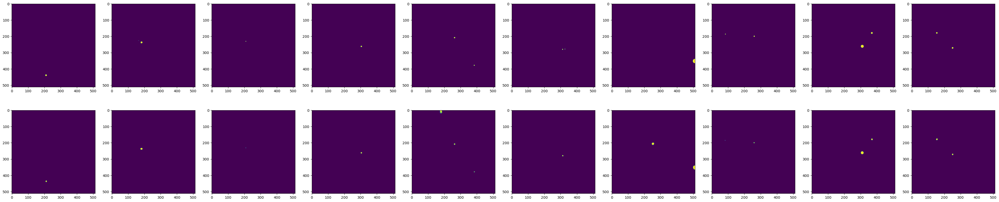

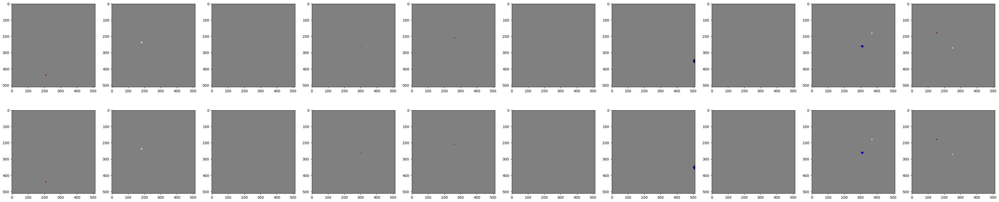

In [20]:
fig,ax_lst = plt.subplots(2,y_part_mask.shape[0],figsize=(y_part_mask.shape[0]*5,2*5))
for idx in range(y_part_mask.shape[0]):
    ax_lst[0,idx].imshow(y_part_mask[idx,:,:].detach().cpu().numpy(),vmin=0,vmax=1)
    ax_lst[1,idx].imshow(y_pred[idx, 0,:,:].detach().cpu().numpy(),vmin=0,vmax=1)

fig,ax_lst = plt.subplots(2,y_part_mask.shape[0],figsize=(y_part_mask.shape[0]*5,2*5))

for idx in range(y_part_mask.shape[0]):
    y_depth_label = y_depth_mask[idx,:,:].detach().cpu().numpy()
    y_depth_label[y_part_mask[idx,:,:].detach().cpu().numpy() == 0] = np.nan
    y_depth_pred = y_pred[idx, 1,:,:].detach().cpu().numpy()
    y_depth_pred[y_part_mask[idx,:,:].detach().cpu().numpy() == 0] = np.nan

    ax_lst[0,idx].imshow(y_depth_label,vmin=-z_max,vmax=z_max,cmap=depth_cmap)
    ax_lst[1,idx].imshow(y_depth_pred,vmin=-z_max,vmax=z_max,cmap=depth_cmap)
    
    # ax_lst[0,idx].imshow(y_depth_mask[idx,:,:].detach().cpu().numpy(),vmin=-1.0,vmax=1.0,cmap=depth_cmap)
    # ax_lst[1,idx].imshow((y_part_mask[idx,:,:]*y_pred[idx, 1,:,:]).detach().cpu().numpy(),vmin=-1.0,vmax=1.0,cmap=depth_cmap)

In [21]:
np.unique(y_depth_mask[1,:,:].detach().cpu().numpy())

array([-0.38027343, -0.1007487 ,  0.        ], dtype=float32)

In [22]:
y_pred[:, 0].shape

torch.Size([10, 512, 512])

In [23]:
x.shape

torch.Size([10, 10, 512, 512])

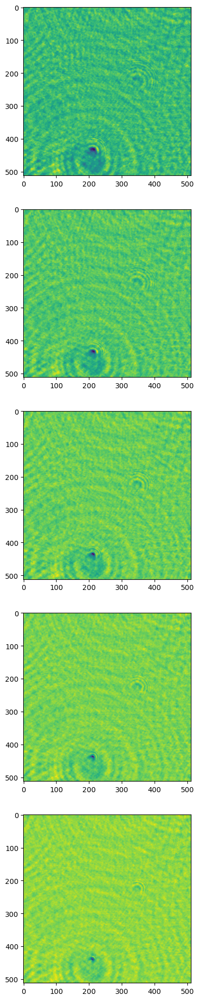

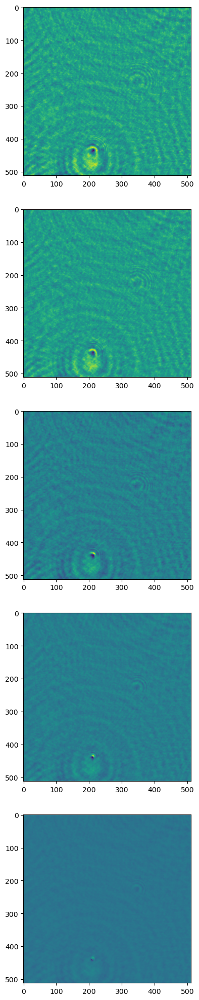

In [24]:
# col_idx_lst = [0,1,2,3,4]
col_idx_lst = np.arange(y_pred.shape[0]//2)
row_idx_lst = [0,]
fig,ax_lst = plt.subplots(len(col_idx_lst),len(row_idx_lst),figsize=(len(row_idx_lst)*5,len(col_idx_lst)*5))
if len(ax_lst.shape) == 0:
    ax_lst = np.array([[ax_lst]])
elif len(ax_lst.shape) == 1:
    ax_lst = ax_lst.reshape(len(col_idx_lst),len(row_idx_lst))
for ax_rw_idx,idx in enumerate(row_idx_lst):
    for ax_cl_idx,col_idx in enumerate(col_idx_lst):
        ax_lst[ax_cl_idx,ax_rw_idx].imshow(x[idx,col_idx,:,:].detach().cpu().numpy())

# col_idx_lst = [3,4,5]
col_idx_lst = np.arange(y_pred.shape[0]//2) + y_pred.shape[0]//2
fig,ax_lst = plt.subplots(len(col_idx_lst),len(row_idx_lst),figsize=(len(row_idx_lst)*5,len(col_idx_lst)*5))
if len(ax_lst.shape) == 0:
    ax_lst = np.array([[ax_lst]])
elif len(ax_lst.shape) == 1:
    ax_lst = ax_lst.reshape(len(col_idx_lst),len(row_idx_lst))
for ax_rw_idx,idx in enumerate(row_idx_lst):
    for ax_cl_idx,col_idx in enumerate(col_idx_lst):
        ax_lst[ax_cl_idx,ax_rw_idx].imshow(x[idx,col_idx,:,:].detach().cpu().numpy())

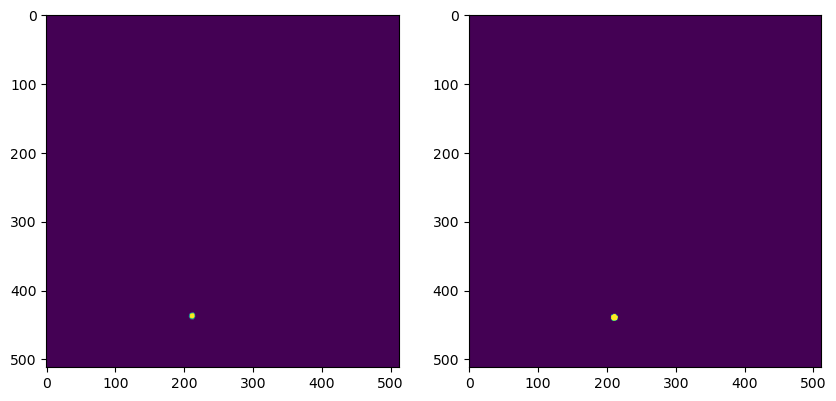

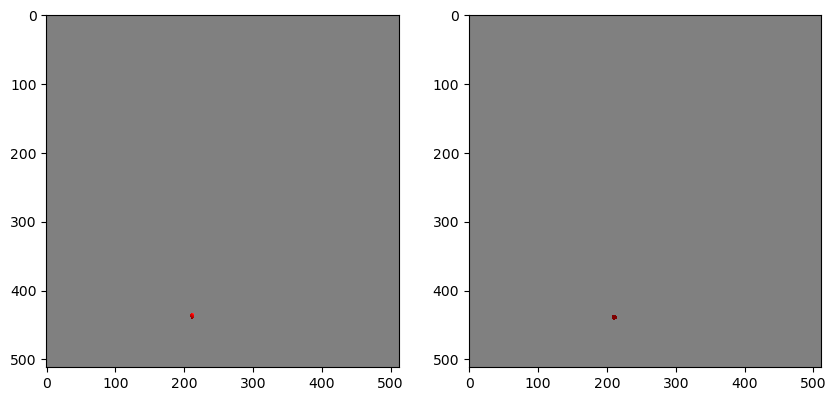

In [25]:
mask_threshold = 0.1

im_base_size = 5
row_idx_lst = [0,]

fig,ax_lst = plt.subplots(len(row_idx_lst),2,figsize=(2*im_base_size,len(row_idx_lst)*im_base_size))
if len(ax_lst.shape) == 0:
    ax_lst = np.array([[ax_lst]])
elif len(ax_lst.shape) == 1:
    ax_lst = ax_lst.reshape(len(row_idx_lst),2)
for idx,rw_idx in enumerate(row_idx_lst):
    ax_lst[idx,1].imshow(y_part_mask[rw_idx,:,:].detach().cpu().numpy(),vmin=0,vmax=1)
    ax_lst[idx,0].imshow(y_pred[rw_idx, 0,:,:].detach().cpu().numpy(),vmin=0,vmax=1)

fig,ax_lst = plt.subplots(len(row_idx_lst),2,figsize=(2*im_base_size,len(row_idx_lst)*im_base_size))
if len(ax_lst.shape) == 0:
    ax_lst = np.array([[ax_lst]])
elif len(ax_lst.shape) == 1:
    ax_lst = ax_lst.reshape(len(row_idx_lst),2)
for idx,rw_idx in enumerate(row_idx_lst):
    y_depth_label = y_depth_mask[rw_idx,:,:].detach().cpu().numpy()
    y_depth_label[y_part_mask[rw_idx,:,:].detach().cpu().numpy() == 0] = np.nan
    y_depth_pred = y_pred[rw_idx, 1,:,:].detach().cpu().numpy()
    y_mask_pred = y_pred[rw_idx, 0,:,:].detach().cpu().numpy()
    # y_depth_pred[y_part_mask[rw_idx,:,:].detach().cpu().numpy() == 0] = np.nan  # use label for masking
    y_depth_pred[y_mask_pred < mask_threshold] = np.nan  # use prediction for masking
    
    ax_lst[idx,1].imshow(y_depth_label,vmin=-z_max,vmax=z_max,cmap=depth_cmap)
    ax_lst[idx,0].imshow(y_depth_pred,vmin=-z_max,vmax=z_max,cmap=depth_cmap)



# col_idx_lst = [0,1,2]
# row_idx_lst = [2,]
# fig,ax_lst = plt.subplots(len(col_idx_lst),len(row_idx_lst),figsize=(len(row_idx_lst)*5,len(col_idx_lst)*5))
# if len(ax_lst.shape) == 0:
#     ax_lst = np.array([[ax_lst]])
# elif len(ax_lst.shape) == 1:
#     ax_lst = ax_lst.reshape(len(col_idx_lst),len(row_idx_lst))
# for ax_rw_idx,idx in enumerate(row_idx_lst):
#     for ax_cl_idx,col_idx in enumerate(col_idx_lst):
#         ax_lst[ax_cl_idx,ax_rw_idx].imshow(x[idx,col_idx,:,:].detach().cpu().numpy())

# col_idx_lst = [3,4,5]
# fig,ax_lst = plt.subplots(len(col_idx_lst),len(row_idx_lst),figsize=(len(row_idx_lst)*5,len(col_idx_lst)*5))
# if len(ax_lst.shape) == 0:
#     ax_lst = np.array([[ax_lst]])
# elif len(ax_lst.shape) == 1:
#     ax_lst = ax_lst.reshape(len(col_idx_lst),len(row_idx_lst))
# for ax_rw_idx,idx in enumerate(row_idx_lst):
#     for ax_cl_idx,col_idx in enumerate(col_idx_lst):
#         ax_lst[ax_cl_idx,ax_rw_idx].imshow(x[idx,col_idx,:,:].detach().cpu().numpy())

Text(0, 0.5, 'Predicted Masked Pixels')

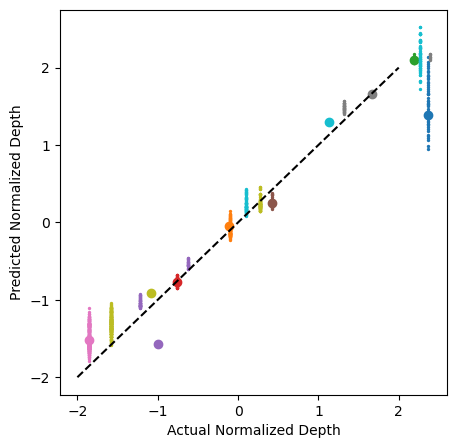

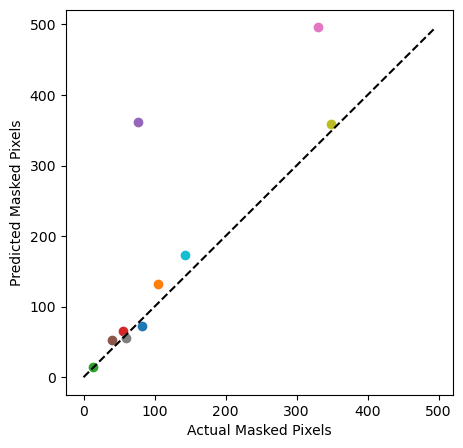

In [26]:
mask_threshold = 0.1
row_idx_lst = np.arange(y_part_mask.shape[0])
# row_idx_lst = [0,1,2,3]
fig,ax = plt.subplots(1,1,figsize=(5,5))
ax.plot([-z_max,z_max],[-z_max,z_max],'k--')
for idx,rw_idx in enumerate(row_idx_lst):
    y_depth_label = y_depth_mask[rw_idx,:,:].detach().cpu().numpy()
    y_depth_label[y_part_mask[rw_idx,:,:].detach().cpu().numpy() == 0] = np.nan
    y_depth_pred = y_pred[rw_idx, 1,:,:].detach().cpu().numpy()
    y_mask_pred = y_pred[rw_idx, 0,:,:].detach().cpu().numpy()
    # y_depth_pred[y_part_mask[rw_idx,:,:].detach().cpu().numpy() == 0] = np.nan  # use label for masking
    y_depth_pred[y_mask_pred < mask_threshold] = np.nan  # use prediction for masking
    ax.scatter(y_depth_label.flatten(),y_depth_pred.flatten(),c=f"C{idx}",s=2)
    ax.scatter(np.nanmean(y_depth_label.flatten()),np.nanmean(y_depth_pred.flatten()),c=f"C{idx}")

# ax.set_xlim([-1.1,1.1])
# ax.set_ylim([-1.1,1.1])
ax.set_xlabel('Actual Normalized Depth')
ax.set_ylabel('Predicted Normalized Depth')


row_idx_lst = np.arange(y_part_mask.shape[0])
# row_idx_lst = [0,1,2,3]
fig,ax = plt.subplots(1,1,figsize=(5,5))
# ax.plot([0,700],[0,700],'k--')
max_pix = 0
for idx,rw_idx in enumerate(row_idx_lst):
    y_depth_label = y_part_mask[rw_idx,:,:].detach().cpu().numpy()
    label_pixels = np.sum(y_depth_label > mask_threshold)
    y_depth_pred = y_pred[rw_idx, 0,:,:].detach().cpu().numpy()
    pred_pixels = np.sum(y_depth_pred > mask_threshold)
    max_pix = np.max([max_pix,pred_pixels,label_pixels])
    if label_pixels == 0 and pred_pixels > 0:
        marker = '+'
    elif label_pixels > 0 and pred_pixels == 0:
        marker = 'x'
    else:
        marker = 'o'
    ax.scatter(label_pixels, pred_pixels,c=f"C{idx}",marker=marker)
ax.plot([0,max_pix],[0,max_pix],'k--')

ax.set_xlabel('Actual Masked Pixels')
ax.set_ylabel('Predicted Masked Pixels')

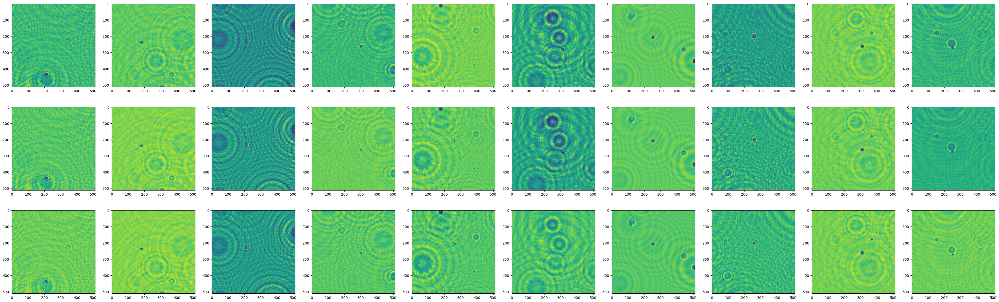

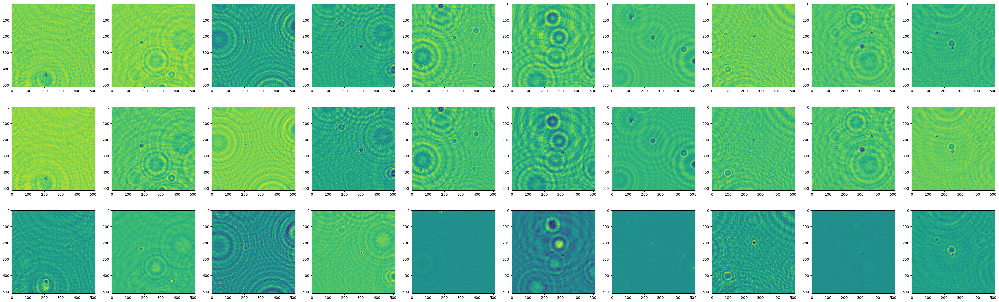

In [27]:

col_idx_lst = [0,1,2]
fig,ax_lst = plt.subplots(len(col_idx_lst),x.shape[0],figsize=(x.shape[0]*5,len(col_idx_lst)*5))
for idx in range(x.shape[0]):
    for ax_idx,col_idx in enumerate(col_idx_lst):
        ax_lst[ax_idx,idx].imshow(x[idx,col_idx,:,:].detach().cpu().numpy())

col_idx_lst = [3,4,5]
fig,ax_lst = plt.subplots(len(col_idx_lst),x.shape[0],figsize=(x.shape[0]*5,len(col_idx_lst)*5))
for idx in range(x.shape[0]):
    for ax_idx,col_idx in enumerate(col_idx_lst):
        ax_lst[ax_idx,idx].imshow(x[idx,col_idx,:,:].detach().cpu().numpy())

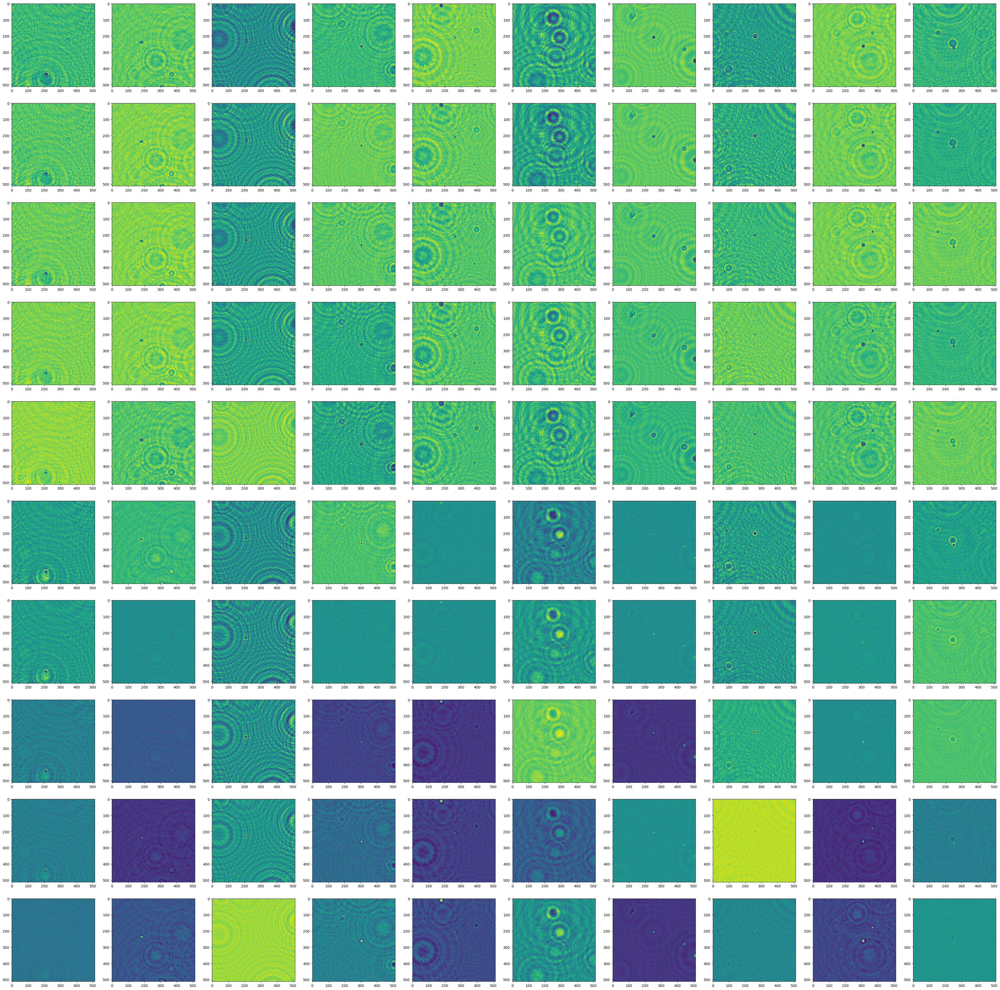

In [28]:
fig,ax_lst = plt.subplots(x.shape[1],x.shape[0],figsize=(x.shape[0]*5,x.shape[1]*5))
for idx in range(x.shape[0]):
    for col_idx in range(x.shape[1]):
        ax_lst[col_idx,idx].imshow(x[idx,col_idx,:,:].detach().cpu().numpy())